In [262]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np

from ete3 import NCBITaxa
from Bio import SeqIO
import taxoniq
import marisa_trie

from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

%matplotlib inline

In [263]:
ncbi = NCBITaxa()

In [264]:
#ncbi.update_taxonomy_database()

In [265]:
# INPUT FILES

#old_taxon_counts = "./data/norg_13__nacc_35__uniform_weight_per_organism__hiseq_reads__v10__report_OLD.csv"
#new_taxon_counts = "./data/norg_13__nacc_35__uniform_weight_per_organism__hiseq_reads__v10__report_NEW.csv"

#old_taxon_counts = "~/Downloads/atcc_even_report_OLD.csv"
#new_taxon_counts = "~/Downloads/atcc_even_report_NEW.csv"

#old_taxon_counts = "~/Downloads/UnAmbiguouslyMapped_ds.buccal_report_OLD.csv"
#new_taxon_counts = "~/Downloads/UnAmbiguouslyMapped_ds.buccal_report_NEW.csv"

#old_taxon_counts = "~/Downloads/UnAmbiguouslyMapped_ds.nycsm_report_OLD.csv"
#new_taxon_counts = "~/Downloads/UnAmbiguouslyMapped_ds.nycsm_report_NEW.csv"

old_taxon_counts = "./data/cityparks/UnAmbiguouslyMapped_ds.cityparks_report_OLD.csv"
new_taxon_counts = "./data/cityparks/UnAmbiguouslyMapped_ds.cityparks_report_NEW.csv"

In [266]:
old_df = pd.read_csv(old_taxon_counts)
new_df = pd.read_csv(new_taxon_counts)

old_df.head()

,tax_id,tax_level,genus_tax_id,name,common_name,category,is_phage,agg_score,max_z_score,nt_z_score,...,nr_alignment_length,nr_e_value,nr_bg_mean,nr_bg_stdev,nr_bg_mean_mass_normalized,nr_bg_stdev_mass_normalized,species_tax_ids,known_pathogen,lcrp_pathogen,divergent_pathogen
0,2800384,2,2800384,Pseudidiomarina,NaN,bacteria,False,NaN,NaN,NaN,...,32.5,10^-12.9125,NaN,NaN,NaN,NaN,"[1517416, 364198]",0,0,0
1,1517416,1,2800384,Pseudidiomarina atlantica,NaN,bacteria,False,NaN,NaN,NaN,...,32.0,10^-12.8665,NaN,NaN,NaN,NaN,NaN,0,0,0
2,364198,1,2800384,Pseudidiomarina homiensis,NaN,bacteria,False,NaN,NaN,NaN,...,33.0,10^-12.9586,NaN,NaN,NaN,NaN,NaN,0,0,0
3,2800373,2,2800373,Priestia,NaN,bacteria,False,NaN,NaN,NaN,...,33.0,10^-9.56253,NaN,NaN,NaN,NaN,[1404],0,0,0
4,1404,1,2800373,Priestia megaterium,NaN,bacteria,False,NaN,NaN,NaN,...,33.0,10^-9.56253,NaN,NaN,NaN,NaN,NaN,0,0,0


In [267]:
old_df.columns

Index(['tax_id', 'tax_level', 'genus_tax_id', 'name', 'common_name',
       'category', 'is_phage', 'agg_score', 'max_z_score', 'nt_z_score',
       'nt_rpm', 'nt_count', 'nt_contigs', 'nt_contig_r',
       'nt_percent_identity', 'nt_alignment_length', 'nt_e_value',
       'nt_bg_mean', 'nt_bg_stdev', 'nt_bg_mean_mass_normalized',
       'nt_bg_stdev_mass_normalized', 'nr_z_score', 'nr_rpm', 'nr_count',
       'nr_contigs', 'nr_contig_r', 'nr_percent_identity',
       'nr_alignment_length', 'nr_e_value', 'nr_bg_mean', 'nr_bg_stdev',
       'nr_bg_mean_mass_normalized', 'nr_bg_stdev_mass_normalized',
       'species_tax_ids', 'known_pathogen', 'lcrp_pathogen',
       'divergent_pathogen'],
      dtype='object')

In [268]:
old_df = old_df[old_df.tax_level == 1][['tax_id', 'name', 'nt_rpm', 'nt_contigs', 'nr_rpm']]
new_df = new_df[new_df.tax_level == 1][['tax_id', 'name', 'nt_rpm', 'nt_contigs', 'nr_rpm']]

In [269]:
all_names = new_df['name']

new_names = []
for n in all_names:
    taxid = n.split()[-1]
    try:
        taxid2name = ncbi.get_taxid_translator([taxid])
        new_names.append(taxid2name[int(taxid)])        
    except:
        new_names.append("None")
        
new_df['fixed_name'] = new_names

In [270]:
old_df.columns

Index(['tax_id', 'name', 'nt_rpm', 'nt_contigs', 'nr_rpm'], dtype='object')

In [271]:
#full_df = old_df.merge(new_df, how='outer', on='tax_id', suffixes = ['_new', '_old'])
full_df = pd.merge(left = old_df, right = new_df, how='outer', on='tax_id', suffixes = ['_old', '_new'])
#full_df = old_df.join(new_df, how='outer', on='tax_id', lsuffix = '_old', rsuffix = '_new')
full_df.head()

,tax_id,name_old,nt_rpm_old,nt_contigs_old,nr_rpm_old,name_new,nt_rpm_new,nt_contigs_new,nr_rpm_new,fixed_name
0,1517416,Pseudidiomarina atlantica,NaN,NaN,0.982628,NaN,NaN,NaN,NaN,NaN
1,364198,Pseudidiomarina homiensis,NaN,NaN,0.982628,NaN,NaN,NaN,NaN,NaN
2,1404,Priestia megaterium,NaN,NaN,1.965256,unnamed species taxon 1404,NaN,NaN,1.965256,Priestia megaterium
3,2799499,Antrihabitans sp. YC3-6,NaN,NaN,0.982628,unnamed species taxon 2799499,NaN,NaN,0.982628,Antrihabitans stalagmiti
4,2799498,Antrihabitans sp. YC2-6,NaN,NaN,1.965256,unnamed species taxon 2799498,NaN,NaN,0.982628,Antrihabitans sp. YC2-6


In [272]:
full_df.dropna(subset=['nt_rpm_old', 'nt_rpm_new'], how='all', inplace=True)
full_df['log_nt_rpm_old'] = np.log(full_df['nt_rpm_old'] + 1)
full_df['log_nt_rpm_new'] = np.log(full_df['nt_rpm_new'] + 1)

full_df.sort_values(by='nt_rpm_old', ascending = False, inplace=True)
full_df.head()

,tax_id,name_old,nt_rpm_old,nt_contigs_old,nr_rpm_old,name_new,nt_rpm_new,nt_contigs_new,nr_rpm_new,fixed_name,log_nt_rpm_old,log_nt_rpm_new
596,940615,Granulicella tundricola,20890.669673,1086.0,19351.874343,unnamed species taxon 940615,20890.669673,1086.0,18362.368023,Granulicella tundricola,9.947106,9.947106
342,119,Rubinisphaera brasiliensis,20849.399300,174.0,17132.117862,unnamed species taxon 119,20849.399300,174.0,13687.024359,Rubinisphaera brasiliensis,9.945128,9.945128
1189,265606,Rhodopirellula baltica,20834.659881,42.0,20795.354764,unnamed species taxon 265606,20834.659881,42.0,20789.458997,Rhodopirellula baltica,9.944421,9.944421
2652,2350,Haliscomenobacter hydrossis,20833.677253,97.0,17958.507946,unnamed species taxon 2350,20835.642509,97.0,17637.188615,Haliscomenobacter hydrossis,9.944374,9.944468
661,658062,Candidatus Koribacter versatilis,20828.764113,170.0,17853.366758,unnamed species taxon 658062,20831.711997,170.0,17563.491521,Candidatus Koribacter versatilis,9.944138,9.944280


In [273]:
full_df.fillna(0, inplace=True)
full_df['diff'] = full_df['nt_rpm_old'] - full_df['nt_rpm_new']
full_df['max_nt_rpm'] = full_df[['nt_rpm_old', 'nt_rpm_new']].max(axis=1)
full_df['perc_diff'] = full_df['diff']/full_df['max_nt_rpm']

full_df.sort_values(by='diff', inplace=True)
top_diffs = full_df.head(5)
bottom_diffs = full_df.tail(5)

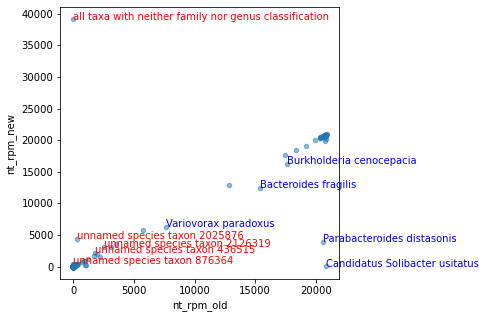

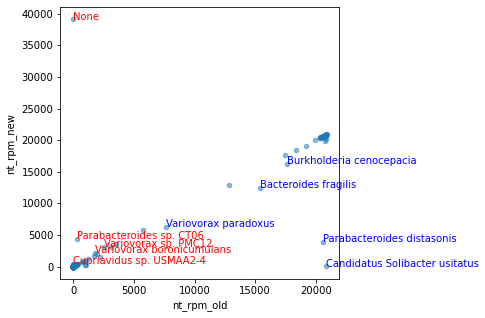

In [274]:
full_df.plot(kind='scatter', x = 'nt_rpm_old', y = 'nt_rpm_new', alpha = .5, figsize=(5,5))
for i in top_diffs.index:
    plt.text(x = top_diffs.loc[i]['nt_rpm_old'], y = top_diffs.loc[i]['nt_rpm_new'], s = top_diffs.loc[i]['name_new'], color='red') #'fixed_name'
for i in bottom_diffs.index:
    plt.text(x = bottom_diffs.loc[i]['nt_rpm_old'], y = bottom_diffs.loc[i]['nt_rpm_new'], s = bottom_diffs.loc[i]['name_old'], color = 'blue')
    
full_df.plot(kind='scatter', x = 'nt_rpm_old', y = 'nt_rpm_new', alpha = .5, figsize=(5,5))
for i in top_diffs.index:
    plt.text(x = top_diffs.loc[i]['nt_rpm_old'], y = top_diffs.loc[i]['nt_rpm_new'], s = top_diffs.loc[i]['fixed_name'], color = 'red')
for i in bottom_diffs.index:
    plt.text(x = bottom_diffs.loc[i]['nt_rpm_old'], y = bottom_diffs.loc[i]['nt_rpm_new'], s = bottom_diffs.loc[i]['name_old'], color = 'blue')

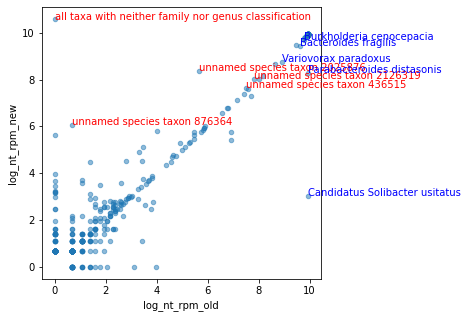

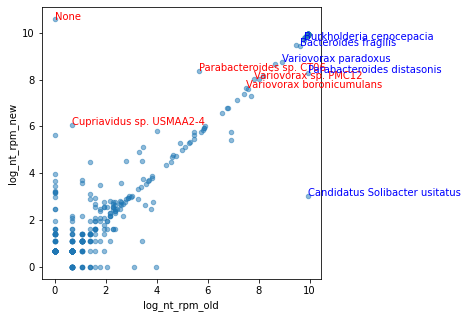

In [275]:
full_df.plot(kind='scatter', x = 'log_nt_rpm_old', y = 'log_nt_rpm_new', alpha = .5, figsize=(5,5))
for i in top_diffs.index:
    plt.text(x = top_diffs.loc[i]['log_nt_rpm_old'], y = top_diffs.loc[i]['log_nt_rpm_new'], s = top_diffs.loc[i]['name_new'], color='red') #'fixed_name'
for i in bottom_diffs.index:
    plt.text(x = bottom_diffs.loc[i]['log_nt_rpm_old'], y = bottom_diffs.loc[i]['log_nt_rpm_new'], s = bottom_diffs.loc[i]['name_old'], color='blue')
    
full_df.plot(kind='scatter', x = 'log_nt_rpm_old', y = 'log_nt_rpm_new', alpha = .5, figsize=(5,5))
for i in top_diffs.index:
    plt.text(x = top_diffs.loc[i]['log_nt_rpm_old'], y = top_diffs.loc[i]['log_nt_rpm_new'], s = top_diffs.loc[i]['fixed_name'], color='red') #'fixed_name'
for i in bottom_diffs.index:
    plt.text(x = bottom_diffs.loc[i]['log_nt_rpm_old'], y = bottom_diffs.loc[i]['log_nt_rpm_new'], s = bottom_diffs.loc[i]['name_old'], color='blue')

In [276]:
top_diffs

,tax_id,name_old,nt_rpm_old,nt_contigs_old,nr_rpm_old,name_new,nt_rpm_new,nt_contigs_new,nr_rpm_new,fixed_name,log_nt_rpm_old,log_nt_rpm_new,diff,max_nt_rpm,perc_diff
5273,-100,all taxa with neither family nor genus classif...,0.000000,0.0,8605.855362,all taxa with neither family nor genus classif...,39087.956205,0.0,43856.649522,None,0.000000,10.573595,-39087.956205,39087.956205,-1.000000
926,2025876,Parabacteroides sp. CT06,285.944726,1.0,86.471257,unnamed species taxon 2025876,4337.319658,313.0,11.791535,Parabacteroides sp. CT06,5.659290,8.375242,-4051.374932,4337.319658,-0.934073
2358,2126319,Variovorax sp. PMC12,2512.579603,19.0,0.000000,unnamed species taxon 2126319,3071.694892,26.0,0.000000,Variovorax sp. PMC12,7.829463,8.030310,-559.115289,3071.694892,-0.182022
1685,876364,Cupriavidus sp. USMAA2-4,0.982628,0.0,0.000000,unnamed species taxon 876364,430.391031,1.0,0.000000,Cupriavidus sp. USMAA2-4,0.684423,6.067015,-429.408403,430.391031,-0.997717
2375,436515,Variovorax boronicumulans,1827.687939,22.0,21.617814,unnamed species taxon 436515,2115.597921,24.0,24.565698,Variovorax boronicumulans,7.511354,7.657565,-287.909982,2115.597921,-0.136089


In [277]:
bottom_diffs

,tax_id,name_old,nt_rpm_old,nt_contigs_old,nr_rpm_old,name_new,nt_rpm_new,nt_contigs_new,nr_rpm_new,fixed_name,log_nt_rpm_old,log_nt_rpm_new,diff,max_nt_rpm,perc_diff
2380,34073,Variovorax paradoxus,7623.227437,74.0,18449.821909,unnamed species taxon 34073,6284.888204,64.0,4820.772597,Variovorax paradoxus,8.939086,8.746062,1338.339233,7623.227437,0.175561
2457,95486,Burkholderia cenocepacia,17584.126707,221.0,14902.535101,unnamed species taxon 95486,16173.073008,218.0,14605.781468,Burkholderia cenocepacia,9.774809,9.691165,1411.053699,17584.126707,0.080246
4093,817,Bacteroides fragilis,15377.144389,570.0,18643.399610,unnamed species taxon 817,12496.079315,508.0,18342.715465,Bacteroides fragilis,9.640703,9.433250,2881.065074,15377.144389,0.187360
947,823,Parabacteroides distasonis,20580.159249,981.0,17448.524054,unnamed species taxon 823,3905.945999,257.0,17292.286214,Parabacteroides distasonis,9.932131,8.270511,16674.213249,20580.159249,0.810208
996,332163,Candidatus Solibacter usitatus,20798.302648,71.0,18285.723045,unnamed species taxon 332163,19.652558,2.0,27.513582,Candidatus Solibacter usitatus,9.942675,3.027839,20778.650089,20798.302648,0.999055


In [278]:
new_organisms_df = full_df[full_df.nt_rpm_old == 0]
new_organisms_df.sort_values(by='nt_rpm_new', ascending = False, inplace=True)
new_organisms_df

/Users/katrina.kalantar/opt/anaconda3/lib/python3.8/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


,tax_id,name_old,nt_rpm_old,nt_contigs_old,nr_rpm_old,name_new,nt_rpm_new,nt_contigs_new,nr_rpm_new,fixed_name,log_nt_rpm_old,log_nt_rpm_new,diff,max_nt_rpm,perc_diff
5273,-100,all taxa with neither family nor genus classif...,0.0,0.0,8605.855362,all taxa with neither family nor genus classif...,39087.956205,0.0,43856.649522,None,0.0,10.573595,-39087.956205,39087.956205,-1.0
6274,1355477,0,0.0,0.0,0.000000,unnamed species taxon 1355477,279.066331,1.0,0.000000,Bradyrhizobium diazoefficiens,0.0,5.635026,-279.066331,279.066331,-1.0
6419,2606626,0,0.0,0.0,0.000000,unnamed species taxon 2606626,52.079280,5.0,24.565698,Sodaliphilus pleomorphus,0.0,3.971787,-52.079280,52.079280,-1.0
6322,1978467,0,0.0,0.0,0.000000,unnamed species taxon 1978467,38.322489,0.0,0.000000,Pseudomonas sp. AK6U,0.0,3.671797,-38.322489,38.322489,-1.0
4525,1338689,Pseudomonas sp. JY-Q,0.0,0.0,63.870815,unnamed species taxon 1338689,30.461466,1.0,63.870815,Pseudomonas sp. JY-Q,0.0,3.448763,-30.461466,30.461466,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6529,2751382,0,0.0,0.0,0.000000,unnamed species taxon 2751382,0.982628,0.0,0.000000,Stx2a-converting phage Stx2_EH2201,0.0,0.684423,-0.982628,0.982628,-1.0
6531,2751377,0,0.0,0.0,0.000000,unnamed species taxon 2751377,0.982628,0.0,0.000000,Stx2a-converting phage Stx2_499,0.0,0.684423,-0.982628,0.982628,-1.0
6532,2751374,0,0.0,0.0,0.000000,unnamed species taxon 2751374,0.982628,0.0,0.000000,Stx1a-converting phage Stx1_14744,0.0,0.684423,-0.982628,0.982628,-1.0
6533,2751371,0,0.0,0.0,0.000000,unnamed species taxon 2751371,0.982628,0.0,0.000000,Stx2a-converting phage Stx2_14040,0.0,0.684423,-0.982628,0.982628,-1.0


In [279]:
#overall correlation!
print(stats.spearmanr(full_df['nt_rpm_old'], full_df['nt_rpm_new']))
print(stats.pearsonr(full_df['nt_rpm_old'], full_df['nt_rpm_new']))

SpearmanrResult(correlation=0.7183420301137174, pvalue=5.667508390569156e-72)
(0.9350108299387903, 5.028775266267644e-202)


In [280]:
# correlation when removing the taxa that are new low-abundance hits -- this is higher, means that the doubling of "new taxa" (false-positives) is driving some of the spearman deviation
print(full_df.shape)
full_df2 = full_df[full_df.nt_rpm_old != 0]
print(full_df2.shape)
print(stats.spearmanr(full_df2['nt_rpm_old'], full_df2['nt_rpm_new']))
print(stats.pearsonr(full_df2['nt_rpm_old'], full_df2['nt_rpm_new']))

(446, 15)
(359, 15)
SpearmanrResult(correlation=0.8781650145179865, pvalue=2.2549974333024184e-116)
(0.9776099676965607, 9.570891416901159e-244)


Text(0.5, 1.0, 'Total Count of Hits, rPM > Threshold')

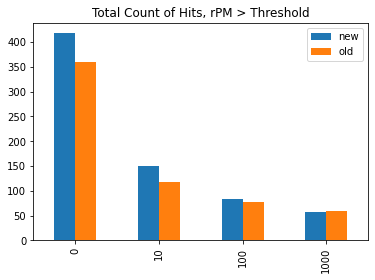

In [281]:
res = {}
for i in [0, 10, 100, 1000]:
    res[str(i)] = {}
    res[str(i)]['new'] = (full_df['nt_rpm_new'] > i).sum()
    res[str(i)]['old'] = (full_df['nt_rpm_old'] > i).sum()
res_df = pd.DataFrame.from_dict(res, orient='index')
res_df

res_df.plot.bar()
plt.title("Total Count of Hits, rPM > Threshold")

# Support Manual Inspection

given a file of reads
given a hitsummary from the other pipeline version (old, if reads come from new or new, if reads come from old)


In [288]:
#Enterococcus faecium reads from old sample...where did they go in new sample?
taxon_contigs = "/Users/katrina.kalantar/Downloads/norg_13__nacc_35__uniform_weight_per_organism__hiseq_reads__v10__tax_490_contigs.fasta" 

'''old_blast_m8_df = pd.read_csv("./data/nycsm/unambiguouslyMapped_ds.nycsm_old.gsnap.blast.m8", sep='\t', header=None)
old_blast_top_m8_df = pd.read_csv("./data/nycsm/unambiguouslyMapped_ds.nycsm_old.gsnap.blast.top.m8", sep='\t', header=None)
old_hitsummary2_df = pd.read_csv("./data/nycsm/unambiguouslyMapped_ds.nycsm_old.gsnap.hitsummary2.tab", sep='\t', header=None)

new_blast_m8_df = pd.read_csv("./data/nycsm/unambiguouslyMapped_ds.nycsm_new.gsnap.blast.m8", sep='\t', header=None)
new_blast_top_m8_df = pd.read_csv("./data/nycsm/unambiguouslyMapped_ds.nycsm_new.gsnap.blast.top.m8", sep='\t', header=None)
new_hitsummary2_df = pd.read_csv("./data/nycsm/unambiguouslyMapped_ds.nycsm_new.gsnap.hitsummary2.tab", sep='\t', header=None)
'''

'''old_blast_m8_df = pd.read_csv("./data/norg13/norg_13__nacc_35__uniform_weight_per_organism__hiseq_reads__v10_OLD.gsnap.blast.m8", sep='\t', header=None)
old_blast_top_m8_df = pd.read_csv("./data/norg13/norg_13__nacc_35__uniform_weight_per_organism__hiseq_reads__v10_OLD.gsnap.blast.top.m8", sep='\t', header=None)
old_hitsummary2_df = pd.read_csv("./data/norg13/norg_13__nacc_35__uniform_weight_per_organism__hiseq_reads__v10_OLD.gsnap.hitsummary2.tab", sep='\t', header=None)

new_blast_m8_df = pd.read_csv("./data/norg13/norg_13__nacc_35__uniform_weight_per_organism__hiseq_reads__v10_NEW.gsnap.blast.m8", sep='\t', header=None)
new_blast_top_m8_df = pd.read_csv("./data/norg13/norg_13__nacc_35__uniform_weight_per_organism__hiseq_reads__v10_NEW.gsnap.blast.top.m8", sep='\t', header=None)
new_hitsummary2_df = pd.read_csv("./data/norg13/norg_13__nacc_35__uniform_weight_per_organism__hiseq_reads__v10_NEW.gsnap.hitsummary2.tab", sep='\t', header=None)
'''

taxon_reads = "/Users/katrina.kalantar/Downloads/UnAmbiguouslyMapped_ds.cityparks_taxon--100-hits.fasta"
old_blast_m8_df = pd.read_csv("./data/cityparks/UnAmbiguouslyMapped_ds.cityparks_report_OLD.gsnap.blast.m8", sep='\t', header=None)
old_blast_top_m8_df = pd.read_csv("./data/cityparks/UnAmbiguouslyMapped_ds.cityparks_report_OLD.gsnap.blast.top.m8", sep='\t', header=None)
old_hitsummary2_df = pd.read_csv("./data/cityparks/UnAmbiguouslyMapped_ds.cityparks_report_OLD.gsnap.hitsummary2.tab", sep='\t', header=None)

new_blast_m8_df = pd.read_csv("./data/cityparks/UnAmbiguouslyMapped_ds.cityparks_report_NEW.gsnap.blast.m8", sep='\t', header=None)
new_blast_top_m8_df = pd.read_csv("./data/cityparks/UnAmbiguouslyMapped_ds.cityparks_report_NEW.gsnap.blast.top.m8", sep='\t', header=None)
new_hitsummary2_df = pd.read_csv("./data/cityparks/UnAmbiguouslyMapped_ds.cityparks_report_NEW.gsnap.hitsummary2.tab", sep='\t', header=None)

In [283]:
list_of_contig_ids = []
for record in SeqIO.parse(taxon_contigs, "fasta"):
    contig_id = record.id.split(':')[0]
    list_of_contig_ids.append(contig_id)

In [284]:
def add_taxon_names(df):
    taxid_list = []
    for i in list(df[1]):
        try:
            taxid = accession_to_taxid_trie[i.split('.')[0]][0][0]
            taxid2name = ncbi.get_taxid_translator([taxid])
            taxid_list.append(taxid2name[int(taxid)][0:26])             
        except:
            taxid_list.append('NA')
    df['taxid'] = taxid_list
    return(df)

def print_hits(contigs, blast_m8_new, blast_m8_old):

    for c in contigs:
        
        print("\n" + c)
        sub_df_new = blast_m8_new[blast_m8_new[0] == c][[1, 2, 3, 11]].head(10)
        sub_df_new2 = add_taxon_names(sub_df_new)
        
        sub_df_old = blast_m8_old[blast_m8_old[0] == c][[1, 2, 3, 11]].head(10)
        sub_df_old2 = add_taxon_names(sub_df_old)
        
        top_taxid_new = sub_df_new2.head(1).iloc[0]['taxid']
        top_taxid_old = sub_df_old2.head(1).iloc[0]['taxid']
        
        print(top_taxid_new)
        
        if(top_taxid_new == top_taxid_old):
            print("same hit")
            #print("new:")
            #print(sub_df_new2.head(5))
            #print("old:")
            #print(sub_df_old.head(5))
        else:
            print("new:")
            print(sub_df_new2.head(5))
            print("old:")
            print(sub_df_old.head(5))
        #print(sub_df2)


In [285]:
print_hits(list_of_contig_ids, new_blast_m8_df, old_blast_m8_df) #show contig hits in new results


NODE_29_length_578_cov_1.682600
Neisseria sicca
new:
                1       2    3     11                 taxid
14355  CP059566.1  90.829  567  749.0       Neisseria sicca
14356  CP059566.1  90.829  567  749.0       Neisseria sicca
14357  CP059566.1  90.829  567  749.0       Neisseria sicca
14358  CP059566.1  90.829  567  749.0       Neisseria sicca
14359  CP039886.1  90.669  568  743.0  Neisseria flavescens
old:
                 1       2    3     11                   taxid
107185  CP031251.1  90.669  568  743.0      Neisseria subflava
107186  CP031251.1  90.669  568  743.0      Neisseria subflava
107187  CP031251.1  90.669  568  743.0      Neisseria subflava
107188  CP031251.1  90.669  568  743.0      Neisseria subflava
107189  LR134522.1  90.669  568  743.0  Neisseria meningitidis


In [303]:
list_of_read_ids = []
for record in SeqIO.parse(taxon_reads, "fasta"):
    #print(record)
    #print(str(record))
    #print('species_nt:-100' in record)
    #print('species_nt:-100' in str(record))
    
    if('species_nt:-100' in str(record.id)):
        read_id = record.id.split(':')[-1]
        list_of_read_ids.append(read_id)
    else:
        print("NT actually isn't -100")
        print(record.id)
list_of_read_ids[0:10]

NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:-200:species_nr:-100:species_nt:152507:NR::NT:FJ661267.1:NC_013131.1-2986647
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:-200:species_nr:-100:species_nt:155900:NR::NT:GQ873075.1:NC_009614.1-869020
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:-200:species_nr:-100:species_nt:155900:NR::NT:GQ873593.1:NC_009614.1-840690
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:-200:species_nr:-100:species_nt:155900:NR::NT:GQ874643.1:NZ_JH724215.1-299714
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:-200:species_nr:-100:species_nt:155900:NR::NT:GQ876223.1:NC_009614.1-814162
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:-200:species_nr:-100:species_nt:155900:NR::NT:GQ876693.1:NC_009614.1-915226
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:-200:spec

family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-685276
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-685283
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-685297
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-685308
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-685340
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-685348
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:

family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-694156
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-694158
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-694181
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-694186
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-694195
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:species_nt:767892:NR::NT:CP001751.1:NC_014010.1-694204
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:767891:species_nr:-100:

NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:357276:NR::NT:CP011531.1:NC_009615.1-543277
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:357276:NR::NT:CP011531.1:NC_009615.1-543598
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:357276:NR::NT:CP011531.1:NC_009615.1-549294
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:357276:NR::NT:CP011531.1:NC_009615.1-563433
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:357276:NR::NT:CP011531.1:NZ_JH724215.1-174304
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:357276:NR::NT:CP011531.1:NZ_JH724215.1-194696
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus

NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR::NT:CP000139.1:NC_009614.1-868190
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR::NT:CP000139.1:NC_009614.1-868414
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR::NT:CP000139.1:NC_009614.1-868418
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR::NT:CP000139.1:NC_009614.1-868525
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR::NT:CP000139.1:NC_009614.1-868641
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR::NT:CP000139.1:NC_009614.1-868704
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:

family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR:WP_011965449.1:NT:CP000139.1:NC_009614.1-820507
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR:WP_011965449.1:NT:CP000139.1:NC_009614.1-850081
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR:WP_011965449.1:NT:CP000139.1:NC_009614.1-857434
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR:WP_011965449.1:NT:CP000139.1:NC_009614.1-876414
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR:WP_011965449.1:NT:CP000139.1:NC_009614.1-877520
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:909656:species_nr:-100:species_nt:821:NR:WP_011965449.1:NT:CP000139.1:NC_009614.1-881444
NT actually isn't -100
family_nr:

NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1226487
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1226490
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1226503
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1226507
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1226508
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1226511
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:gen

NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1234227
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1234229
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1234238
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1234241
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1234253
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1234268
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:gen

NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1244048
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1244051
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1244059
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1244062
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1244069
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1244077
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:gen

NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1251414
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1251416
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1251431
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1251435
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1251437
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR::NT:CP002568.1:NC_015259.1-1251464
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:gen

family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR:WP_162858365.1:NT:CP002568.1:NC_015259.1-1237446
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR:WP_168458586.1:NT:CP002568.1:NC_015259.1-1231231
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR:WP_176074435.1:NT:CP002568.1:NC_015259.1-1241894
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR:WP_179956161.1:NT:CP002568.1:NC_015259.1-1235943
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR:WP_183262054.1:NT:CP002568.1:NC_015259.1-1233664
NT actually isn't -100
family_nr:-300:family_nt:-300:genus_nr:-200:genus_nt:991903:species_nr:-100:species_nt:991904:NR:WP_186387050.1:NT:CP002568.1:NC_015259.1-1241783
NT actual

NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1476999
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1477004
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1477023
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1477024
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1477025
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1477031
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:speci

NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1483295
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1483335
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1483349
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1483352
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1483360
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1483365
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:speci

family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1490763
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1490764
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1490767
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1490771
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1490782
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1490783
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:1

NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1496529
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1496538
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1496541
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1496546
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1496556
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:120:NR::NT:CP001744.1:NC_014148.1-1496557
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:speci

NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:2528019:NR::NT:CP036299.1:NC_014148.1-1483946
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:2528019:NR::NT:CP036299.1:NC_014148.1-1484260
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:2528019:NR::NT:CP036299.1:NC_014148.1-1484845
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:2528019:NR::NT:CP036299.1:NC_014148.1-1484915
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:2528019:NR::NT:CP036299.1:NC_014148.1-1484935
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649480:species_nr:-100:species_nt:2528019:NR::NT:CP036299.1:NC_014148.1-1485211
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-20

NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1657452
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1657453
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1657459
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1657472
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1657476
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1657477
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:speci

family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1663258
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1663263
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1663264
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1663289
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1663302
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1663316
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:1

family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1669533
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1669543
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1669553
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1669556
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1669559
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1669566
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:1

family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1676040
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1676041
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1676054
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1676097
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1676099
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR::NT:CP002546.1:NC_015174.1-1676102
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:1

NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR:WP_013630733.1:NT:CP002546.1:NC_015174.1-1674723
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR:WP_013630739.1:NT:CP002546.1:NC_015174.1-1654642
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR:WP_013630739.1:NT:CP002546.1:NC_015174.1-1660333
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR:WP_013630739.1:NT:CP002546.1:NC_015174.1-1662136
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR:WP_013630783.1:NT:CP002546.1:NC_015174.1-1662954
NT actually isn't -100
family_nr:-300:family_nt:126:genus_nr:-200:genus_nt:1649490:species_nr:-100:species_nt:119:NR:WP_013630783.1:NT:CP002546.1:NC_015174.1-1663625
NT a

NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:287:NR::NT:CP006705.1:NC_002516.2-1421004
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:287:NR::NT:CP006705.1:NC_002516.2-1422121
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:287:NR::NT:CP006705.1:NC_002516.2-1425456
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:287:NR::NT:CP006705.1:NC_002516.2-1431654
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:287:NR::NT:CP006705.1:NC_002516.2-1431870
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:287:NR::NT:CP006705.1:NC_002516.2-1433831
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-

family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:303:NR::NT:CP003588.1:NZ_AKCL01000049.1-2124
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:303:NR::NT:CP003588.1:NZ_AKCL01000049.1-227
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:303:NR::NT:CP003588.1:NZ_AKCL01000049.1-2304
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:303:NR::NT:CP003588.1:NZ_AKCL01000049.1-2339
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:303:NR::NT:CP003588.1:NZ_AKCL01000049.1-2962
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:species_nt:303:NR::NT:CP003588.1:NZ_AKCL01000049.1-3027
NT actually isn't -100
family_nr:-300:family_nt:135621:genus_nr:-200:genus_nt:286:species_nr:-100:sp

NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-225644
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-225667
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-225724
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-225785
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-225856
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-225871
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:specie

NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-257235
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-257242
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-257371
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-257390
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-257447
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP002122.1:NC_014370.1-257470
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:specie

NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP022040.2:NC_014370.1-242430
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP022040.2:NC_014370.1-242521
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP022040.2:NC_014370.1-242559
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP022040.2:NC_014370.1-242636
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP022040.2:NC_014370.1-242699
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:species_nr:-100:species_nt:28132:NR::NT:CP022040.2:NC_014370.1-242735
NT actually isn't -100
family_nr:-300:family_nt:171552:genus_nr:-200:genus_nt:838:specie

family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP009494.1:NC_008596.1-1932649
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP009494.1:NC_008596.1-1932663
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP009494.1:NC_008596.1-1932706
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP009494.1:NC_008596.1-1932719
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP009494.1:NC_008596.1-1932721
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP009494.1:NC_008596.1-1932727
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100

NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP054795.1:NC_008596.1-1923608
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP054795.1:NC_008596.1-1923635
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP054795.1:NC_008596.1-1923657
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP054795.1:NC_008596.1-1923701
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP054795.1:NC_008596.1-1923750
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR::NT:CP054795.1:NC_008596.1-1923755
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:

NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR:WP_011727943.1:NT:CP054795.1:NC_008596.1-1946363
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR:WP_011728034.1:NT:CP009494.1:NC_008596.1-1924551
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR:WP_011728082.1:NT:CP009494.1:NC_008596.1-1934849
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR:WP_011728184.1:NT:CP054795.1:NC_008596.1-1938413
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR:WP_011728192.1:NT:CP054795.1:NC_008596.1-1942767
NT actually isn't -100
family_nr:-300:family_nt:1762:genus_nr:-200:genus_nt:1866885:species_nr:-100:species_nt:1772:NR:WP_011728256.1:NT:CP009494.1:NC_008596.1-

family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1494858
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1494866
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1494867
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1494871
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1494877
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1494882
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:1

NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1500624
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1500625
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1500628
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1500631
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1500644
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1500664
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:speci

NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1506471
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1506514
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1506516
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1506517
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1506518
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1506519
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:speci

NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1511926
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1511931
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1511942
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1511949
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1511959
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR::NT:CP002353.1:NC_014962.1-1511961
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:speci

NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR:WP_013564812.1:NT:CP002353.1:NC_014962.1-1499524
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR:WP_013564812.1:NT:CP002353.1:NC_014962.1-1500909
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR:WP_013564812.1:NT:CP002353.1:NC_014962.1-1500989
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR:WP_013564812.1:NT:CP002353.1:NC_014962.1-1502979
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR:WP_013564812.1:NT:CP002353.1:NC_014962.1-1504394
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:127:species_nr:-100:species_nt:128:NR:WP_013564812.1:NT:CP002353.1:NC_014962.1-1504786
NT a

NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2742207
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2742211
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2742213
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2742214
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2742219
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2742235
NT actually isn't -100
family_nr:-300:family_nt:1763

family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2747344
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2747362
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2747364
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2747372
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2747376
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2747382
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus

NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2753264
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2753270
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2753274
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2753291
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2753296
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2753300
NT actually isn't -100
family_nr:-300:family_nt:1763

NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2759135
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2759138
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2759145
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2759148
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2759150
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR::NT:CP003364.1:NC_019892.1-2759152
NT actually isn't -100
family_nr:-300:family_nt:1763

NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR:WP_015245511.1:NT:CP003364.1:NC_019892.1-2752355
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR:WP_015245531.1:NT:CP003364.1:NC_019892.1-2738671
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR:WP_015245592.1:NT:CP003364.1:NC_019892.1-2754857
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR:WP_015245592.1:NT:CP003364.1:NC_019892.1-2755228
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR:WP_015245592.1:NT:CP003364.1:NC_019892.1-2758871
NT actually isn't -100
family_nr:-300:family_nt:1763524:genus_nr:-200:genus_nt:466152:species_nr:-100:species_nt:466153:NR:WP_015245623.1:NT

family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2359640
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2359642
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2359643
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2359662
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2359674
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2359689
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100

NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2367358
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2367360
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2367378
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2367390
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2367392
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2367404
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_

family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2376137
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2376153
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2376156
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2376169
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2376179
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR::NT:CP002691.1:NC_015510.1-2376201
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100

NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR:WP_013766820.1:NT:CP002691.1:NC_015510.1-2365685
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR:WP_013766820.1:NT:CP002691.1:NC_015510.1-2366592
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR:WP_013766820.1:NT:CP002691.1:NC_015510.1-2370616
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR:WP_013766858.1:NT:CP002691.1:NC_015510.1-2372464
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR:WP_013766887.1:NT:CP002691.1:NC_015510.1-2366045
NT actually isn't -100
family_nr:-300:family_nt:1937961:genus_nr:-200:genus_nt:2349:species_nr:-100:species_nt:2350:NR:WP_013766887.1:NT:CP002691.1:NC_015510.1-

NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2930772
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2930781
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2930784
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2930786
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2930811
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2930830
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-1

NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2937077
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2937081
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2937096
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2937108
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2937124
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2937126
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-1

family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2943647
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2943648
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2943696
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2943708
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2943728
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2943730
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::

family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2949843
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2949847
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2949860
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2949864
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2949867
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::NT:CP001814.1:NC_013595.1-2949887
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR::

NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR:WP_012891834.1:NT:CP001814.1:NC_013595.1-2929693
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR:WP_012891834.1:NT:CP001814.1:NC_013595.1-2939768
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR:WP_012891834.1:NT:CP001814.1:NC_013595.1-2946380
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR:WP_012891869.1:NT:CP001814.1:NC_013595.1-2930236
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR:WP_012891869.1:NT:CP001814.1:NC_013595.1-2940632
NT actually isn't -100
family_nr:-300:family_nt:2004:genus_nr:-200:genus_nt:2000:species_nr:-100:species_nt:2001:NR:WP_012891869.1:NT:CP001814.1:NC_013595.1-2948032
NT actuall

NT actually isn't -100
family_nr:-300:family_nt:2005525:genus_nr:-200:genus_nt:375288:species_nr:-100:species_nt:823:NR:WP_005860563.1:NT:LR215978.1:NC_009615.1-487945
NT actually isn't -100
family_nr:-300:family_nt:2005525:genus_nr:-200:genus_nt:375288:species_nr:-100:species_nt:823:NR:WP_005861273.1:NT:LR215978.1:NC_009615.1-568090
NT actually isn't -100
family_nr:-300:family_nt:2005525:genus_nr:-200:genus_nt:375288:species_nr:-100:species_nt:823:NR:WP_008781023.1:NT:LR215978.1:NC_009615.1-537636
NT actually isn't -100
family_nr:-300:family_nt:2005525:genus_nr:-200:genus_nt:375288:species_nr:-100:species_nt:823:NR:WP_008781024.1:NT:LR215978.1:NC_009615.1-407403
NT actually isn't -100
family_nr:-300:family_nt:2005525:genus_nr:-200:genus_nt:375288:species_nr:-100:species_nt:823:NR:WP_011966208.1:NT:LR215978.1:NC_009615.1-487979
NT actually isn't -100
family_nr:-300:family_nt:2005525:genus_nr:-200:genus_nt:375288:species_nr:-100:species_nt:823:NR:WP_011966208.1:NT:LR215978.1:NC_009615.1

family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1553355
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1553358
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1553379
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1553383
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1553385
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1553391
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658

NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1560303
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1560312
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1560357
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1560359
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1560361
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:CP000360.1:NC_008009.1-1560366
NT actually isn't -100
family_nr:-300:family_nt:204434:gen

NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR::NT:NR_076424.1:NC_008009.1-1555342
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR:HFG88590.1:NT:CP000360.1:NC_008009.1-1546377
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR:HHS41305.1:NT:CP000360.1:NC_008009.1-1547649
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR:WP_011520815.1:NT:CP000360.1:NC_008009.1-1548598
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR:WP_011520815.1:NT:CP000360.1:NC_008009.1-1549751
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:658061:species_nr:-100:species_nt:658062:NR:WP_011520815.1:NT:CP000360.1:NC_008009.1-155

family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1723659
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1723672
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1723711
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1723716
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1723724
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1723729
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940

family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1731549
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1731586
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1731590
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1731601
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1731602
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1731613
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940

NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1739074
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1739079
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1739097
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1739101
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1739102
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR::NT:CP003130.1:NC_016631.1-1739103
NT actually isn't -100
family_nr:-300:family_nt:204434:gen

NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR:WP_014265281.1:NT:CP003130.1:NC_016631.1-1737255
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR:WP_014265281.1:NT:CP003130.1:NC_016631.1-1737523
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR:WP_014265281.1:NT:CP003130.1:NC_016631.1-1739490
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR:WP_014265281.1:NT:CP003130.1:NC_016631.1-1742073
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR:WP_014265281.1:NT:CP003130.1:NC_016631.1-1742676
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940614:NR:WP_014265281.1:NT:CP003

NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940615:NR::NT:CP002481.1:NC_015057.1-4835
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940615:NR::NT:CP002481.1:NC_015057.1-4857
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940615:NR::NT:CP002481.1:NC_015057.1-4864
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940615:NR::NT:CP002481.1:NC_015057.1-4878
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940615:NR::NT:CP002481.1:NC_015057.1-4904
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_nt:940557:species_nr:-100:species_nt:940615:NR::NT:CP002481.1:NC_015057.1-4919
NT actually isn't -100
family_nr:-300:family_nt:204434:genus_nr:-200:genus_n

family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2982881
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2982928
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2982941
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2982968
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2982971
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2982983
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:682

family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2992406
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2992407
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2992410
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2992419
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2992425
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-2992434
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:682

NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3002382
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3002393
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3002401
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3002420
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3002423
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3002431
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species

NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3012147
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3012159
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3012164
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3012173
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3012186
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR::NT:CP002994.1:NC_015957.1-3012193
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species

NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR:WP_086886475.1:NT:CP002994.1:NC_015957.1-2984225
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR:WP_093463967.1:NT:CP002994.1:NC_015957.1-2997642
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR:WP_093465213.1:NT:CP002994.1:NC_015957.1-2991447
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR:WP_093465213.1:NT:CP002994.1:NC_015957.1-3003037
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR:WP_093465784.1:NT:CP002994.1:NC_015957.1-2990044
NT actually isn't -100
family_nr:-300:family_nt:2062:genus_nr:-200:genus_nt:1883:species_nr:-100:species_nt:68280:NR:WP_093468311.1:NT:CP002994.1:NC_015957.1-2995225
NT a

family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2516575
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2516595
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2516629
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2516651
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2516658
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2516668
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_0157

NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2528241
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2528250
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2528253
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2528259
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2528263
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2528266
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR

family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2540128
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2540134
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2540161
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2540172
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2540199
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_015711.1-2540208
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR::NT:CP002830.1:NC_0157

family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR:WP_095956738.1:NT:CP022203.1:NC_015711.1-2532303
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR:WP_095956929.1:NT:CP002830.1:NC_015711.1-2514171
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR:WP_095956929.1:NT:CP002830.1:NC_015711.1-2534250
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR:WP_095956929.1:NT:CP022203.1:NC_015711.1-2514388
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR:WP_095956929.1:NT:CP022203.1:NC_015711.1-2521254
NT actually isn't -100
family_nr:-300:family_nt:31:genus_nr:-200:genus_nt:83461:species_nr:-100:species_nt:35:NR:WP_095957063.1:NT:CP022203.1:NC_015711.1-2535161
NT actually isn't -100
family_nr:-300:family_nt:31:

family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2972959
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2972962
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2972970
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2972980
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2972981
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2972994
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414

family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2979716
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2979721
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2979737
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2979743
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2979753
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2979757
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414

NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2987562
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2987578
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2987595
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2987605
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2987607
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2987610
NT actually isn't -100
family_nr:-300:family_nt:414877:gen

family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2994553
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2994555
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2994566
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2994574
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2994575
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR::NT:CP001700.1:NC_013131.1-2994588
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414

NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR:WP_015792236.1:NT:CP001700.1:NC_013131.1-2975262
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR:WP_015792236.1:NT:CP001700.1:NC_013131.1-2976362
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR:WP_015792236.1:NT:CP001700.1:NC_013131.1-2984374
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR:WP_015792266.1:NT:CP001700.1:NC_013131.1-2973609
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR:WP_015792266.1:NT:CP001700.1:NC_013131.1-2985259
NT actually isn't -100
family_nr:-300:family_nt:414877:genus_nr:-200:genus_nt:414878:species_nr:-100:species_nt:304895:NR:WP_015792266.1:NT:CP001

NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP002534.1:NC_015167.1-238480
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP002534.1:NC_015167.1-238576
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP002534.1:NC_015167.1-238773
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP002534.1:NC_015167.1-238884
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP002534.1:NC_015167.1-239228
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP002534.1:NC_015167.1-239271
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:spec

NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP015172.1:NC_015167.1-229595
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP015172.1:NC_015167.1-230214
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP015172.1:NC_015167.1-230395
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP015172.1:NC_015167.1-230644
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP015172.1:NC_015167.1-230767
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR::NT:CP015172.1:NC_015167.1-231682
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:spec

NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR:WP_013622359.1:NT:CP002534.1:NC_015167.1-228648
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR:WP_013622359.1:NT:CP002534.1:NC_015167.1-273603
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR:WP_013622359.1:NT:CP002534.1:NC_015167.1-276940
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR:WP_013622359.1:NT:CP002534.1:NC_015167.1-287647
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR:WP_013622359.1:NT:CP002534.1:NC_015167.1-338628
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:104264:species_nr:-100:species_nt:979:NR:WP_013622382.1:NT:CP002534.1:NC_015167.1-213681
NT a

family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1366027
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1366053
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1366055
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1366069
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1366073
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1366076
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:spe

NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1375740
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1375743
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1375746
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1375759
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1375770
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1375772
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-

NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1385612
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1385619
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1385624
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1385639
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1385644
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-200:genus_nt:417127:species_nr:-100:species_nt:398743:NR::NT:CP001650.1:NC_014041.1-1385670
NT actually isn't -100
family_nr:-300:family_nt:49546:genus_nr:-

NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3746077
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3746110
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3746128
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3746146
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3746149
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3746152
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR

family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3752352
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3752353
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3752362
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3752380
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3752381
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3752405
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_0101

NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3759229
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3759232
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3759233
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3759241
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3759268
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3759269
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR

NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3765402
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3765403
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3765405
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3765416
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3765428
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3765432
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR

family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3771979
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3771985
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3771996
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3771998
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3772005
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_010162.1-3772006
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR::NT:AM746676.1:NC_0101

family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR:WP_157907118.1:NT:AM746676.1:NC_010162.1-3760224
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR:WP_157907270.1:NT:AM746676.1:NC_010162.1-3754863
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR:WP_157907291.1:NT:AM746676.1:NC_010162.1-3745159
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR:WP_157907291.1:NT:AM746676.1:NC_010162.1-3757638
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR:WP_157907365.1:NT:AM746676.1:NC_010162.1-3758533
NT actually isn't -100
family_nr:-300:family_nt:49:genus_nr:-200:genus_nt:39643:species_nr:-100:species_nt:56:NR:WP_157907402.1:NT:AM746676.1:NC_010162.1-3762084
NT actually isn't -100
family_nr:-300:family_nt:49:

NT actually isn't -100
family_nr:-300:family_nt:543:genus_nr:-200:genus_nt:590:species_nr:-100:species_nt:28901:NR::NT:CP000886.1:NC_010102.1-1301188
NT actually isn't -100
family_nr:-300:family_nt:543:genus_nr:-200:genus_nt:590:species_nr:-100:species_nt:28901:NR::NT:CP000886.1:NC_010102.1-1301369
NT actually isn't -100
family_nr:-300:family_nt:543:genus_nr:-200:genus_nt:590:species_nr:-100:species_nt:28901:NR::NT:CP000886.1:NC_010102.1-1301673
NT actually isn't -100
family_nr:-300:family_nt:543:genus_nr:-200:genus_nt:590:species_nr:-100:species_nt:28901:NR::NT:CP000886.1:NC_010102.1-1302044
NT actually isn't -100
family_nr:-300:family_nt:543:genus_nr:-200:genus_nt:590:species_nr:-100:species_nt:28901:NR::NT:CP000886.1:NC_010102.1-1302062
NT actually isn't -100
family_nr:-300:family_nt:543:genus_nr:-200:genus_nt:590:species_nr:-100:species_nt:28901:NR::NT:CP000886.1:NC_010102.1-1302084
NT actually isn't -100
family_nr:-300:family_nt:543:genus_nr:-200:genus_nt:590:species_nr:-100:speci

family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1691726
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1691738
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1691739
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1691761
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1691764
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1691765
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:speci

family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1701311
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1701312
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1701321
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1701329
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1701336
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1701337
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:speci

family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1709996
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1710010
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1710015
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1710028
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1710040
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR::NT:CP002955.1:NC_015914.1-1710066
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:speci

NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR:WP_014018786.1:NT:CP002955.1:NC_015914.1-1703602
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR:WP_014018786.1:NT:CP002955.1:NC_015914.1-1703897
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR:WP_014018786.1:NT:CP002955.1:NC_015914.1-1705614
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR:WP_014018786.1:NT:CP002955.1:NC_015914.1-1707997
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR:WP_014018805.1:NT:CP002955.1:NC_015914.1-1698392
NT actually isn't -100
family_nr:-300:family_nt:563798:genus_nr:-200:genus_nt:68288:species_nr:-100:species_nt:104:NR:WP_014018820.1:NT:CP002955.1:NC_015914.1-170553

family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-920029
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-920049
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-920052
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-920060
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-920084
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-920095
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:sp

NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-932471
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-932475
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-932477
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-932488
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-932497
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP000159.1:NC_007677.1-932506
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:

family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP030361.1:NC_007677.1-936954
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP030361.1:NC_007677.1-936970
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP030361.1:NC_007677.1-936993
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP030361.1:NC_007677.1-937084
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP030361.1:NC_007677.1-937151
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR::NT:CP030361.1:NC_007677.1-937255
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:sp

NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR:WP_164923588.1:NT:CP000159.1:NC_007677.1-919528
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR:WP_164923624.1:NT:CP000159.1:NC_007677.1-913223
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR:WP_164923627.1:NT:CP000159.1:NC_007677.1-919921
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR:WP_164923672.1:NT:CP000159.1:NC_007677.1-928236
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR:WP_164923673.1:NT:CP000159.1:NC_007677.1-929433
NT actually isn't -100
family_nr:-300:family_nt:563843:genus_nr:-200:genus_nt:146918:species_nr:-100:species_nt:146919:NR:WP_164923691.1:NT:CP000159.1

NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1224534
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1224577
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1224590
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1224612
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1224618
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1224634
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species

NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1240639
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1240651
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1240666
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1240675
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1240713
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP003841.1:NC_018632.1-1240730
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species

family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP014323.1:NC_018632.1-1232259
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP014323.1:NC_018632.1-1232414
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP014323.1:NC_018632.1-1232629
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP014323.1:NC_018632.1-1232913
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP014323.1:NC_018632.1-1233054
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:28108:NR::NT:CP014323.1:NC_018632.1-1233075
NT actually isn't -100
family_nr:-300:family_nt:72275:genus_nr:-200:genus_nt:226:species_nr:-100:species_nt:281

NT actually isn't -100
family_nr:-300:family_nt:72293:genus_nr:-200:genus_nt:209:species_nr:-100:species_nt:210:NR::NT:CP002071.1:NC_017355.1-311817
NT actually isn't -100
family_nr:-300:family_nt:72293:genus_nr:-200:genus_nt:209:species_nr:-100:species_nt:210:NR::NT:CP002071.1:NC_017355.1-312352
NT actually isn't -100
family_nr:-300:family_nt:72293:genus_nr:-200:genus_nt:209:species_nr:-100:species_nt:210:NR::NT:CP002071.1:NC_017355.1-314708
NT actually isn't -100
family_nr:-300:family_nt:72293:genus_nr:-200:genus_nt:209:species_nr:-100:species_nt:210:NR::NT:CP002071.1:NC_017355.1-314867
NT actually isn't -100
family_nr:-300:family_nt:72293:genus_nr:-200:genus_nt:209:species_nr:-100:species_nt:210:NR::NT:CP002071.1:NC_017355.1-317445
NT actually isn't -100
family_nr:-300:family_nt:72293:genus_nr:-200:genus_nt:209:species_nr:-100:species_nt:210:NR::NT:CP002071.1:NC_017355.1-321304
NT actually isn't -100
family_nr:-300:family_nt:72293:genus_nr:-200:genus_nt:209:species_nr:-100:species_n

NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1027834
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1027840
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1027855
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1028002
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1028012
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1028029
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:specie

NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1063679
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1063700
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1063724
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1063832
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1063850
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1063923
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:specie

family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1095532
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1095573
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1095606
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1095684
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1095695
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1095768
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:18

NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1136337
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1136352
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1136360
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1136459
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1136517
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1136648
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:specie

family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1172454
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1172489
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1172522
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1172529
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1172533
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR::NT:CT573213.2:NC_008278.1-1172611
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:18

family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011601448.1:NT:CT573213.2:NC_008278.1-1037426
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011601448.1:NT:CT573213.2:NC_008278.1-1077670
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011601448.1:NT:CT573213.2:NC_008278.1-1092985
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011601448.1:NT:CT573213.2:NC_008278.1-1117032
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011601448.1:NT:CT573213.2:NC_008278.1-1161585
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011601448.1:NT:CT573213.2:NC_008278.1-1176682
NT actually isn't -100
fami

family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011603719.1:NT:CT573213.2:NC_008278.1-1071074
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011603719.1:NT:CT573213.2:NC_008278.1-1114006
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011603719.1:NT:CT573213.2:NC_008278.1-1177388
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011603719.1:NT:CT573213.2:NC_008278.1-1178723
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011603719.1:NT:CT573213.2:NC_008278.1-980282
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011603719.1:NT:CT573213.2:NC_008278.1-988211
NT actually isn't -100
family

NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011604640.1:NT:CT573213.2:NC_008278.1-1095238
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011604643.1:NT:CT573213.2:NC_008278.1-1066462
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011604643.1:NT:CT573213.2:NC_008278.1-1099637
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011604643.1:NT:CT573213.2:NC_008278.1-1131373
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011604668.1:NT:CT573213.2:NC_008278.1-1011651
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011604668.1:NT:CT573213.2:NC_008278.1-1014473
NT a

NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011606532.1:NT:CT573213.2:NC_008278.1-1152156
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011606532.1:NT:CT573213.2:NC_008278.1-1164686
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011606532.1:NT:CT573213.2:NC_008278.1-1175881
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011606532.1:NT:CT573213.2:NC_008278.1-999374
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011606535.1:NT:CT573213.2:NC_008278.1-1085829
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_011606535.1:NT:CT573213.2:NC_008278.1-1172720
NT ac

NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_044888454.1:NT:CT573213.2:NC_008278.1-1093463
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_044888537.1:NT:CT573213.2:NC_008278.1-1024345
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_044888546.1:NT:CT573213.2:NC_008278.1-1061818
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_044888546.1:NT:CT573213.2:NC_008278.1-1083035
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_044888546.1:NT:CT573213.2:NC_008278.1-1089730
NT actually isn't -100
family_nr:-300:family_nt:74712:genus_nr:-200:genus_nt:1854:species_nr:-100:species_nt:1859:NR:WP_044888546.1:NT:CT573213.2:NC_008278.1-1101294
NT a

family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1222661
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1222690
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1222692
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1222696
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1222698
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1222728
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::

NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1240855
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1240860
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1240880
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1240915
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1240932
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP002008.1:NC_014100.1-1240944
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-10

NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP027850.1:NC_014100.1-1230196
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP027850.1:NC_014100.1-1230201
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP027850.1:NC_014100.1-1230239
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP027850.1:NC_014100.1-1230240
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP027850.1:NC_014100.1-1230287
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR::NT:CP027850.1:NC_014100.1-1230306
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-10

NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR:WP_013077460.1:NT:CP002008.1:NC_014100.1-1247952
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR:WP_013077460.1:NT:CP027850.1:NC_014100.1-1239971
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR:WP_013077463.1:NT:CP002008.1:NC_014100.1-1232359
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR:WP_013077463.1:NT:CP027850.1:NC_014100.1-1243232
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR:WP_013077547.1:NT:CP002008.1:NC_014100.1-1228088
NT actually isn't -100
family_nr:-300:family_nt:76892:genus_nr:-200:genus_nt:75:species_nr:-100:species_nt:88688:NR:WP_013077547.1:NT:CP027850.1:NC_014100.1-1236507
NT actuall

NT actually isn't -100
family_nr:-300:family_nt:815:genus_nr:-200:genus_nt:816:species_nr:-100:species_nt:817:NR::NT:AP006841.1:NZ_JH724215.1-207634
NT actually isn't -100
family_nr:-300:family_nt:815:genus_nr:-200:genus_nt:816:species_nr:-100:species_nt:817:NR::NT:AP006841.1:NZ_JH724215.1-207722
NT actually isn't -100
family_nr:-300:family_nt:815:genus_nr:-200:genus_nt:816:species_nr:-100:species_nt:817:NR::NT:AP006841.1:NZ_JH724215.1-208096
NT actually isn't -100
family_nr:-300:family_nt:815:genus_nr:-200:genus_nt:816:species_nr:-100:species_nt:817:NR::NT:AP006841.1:NZ_JH724215.1-209060
NT actually isn't -100
family_nr:-300:family_nt:815:genus_nr:-200:genus_nt:816:species_nr:-100:species_nt:817:NR::NT:AP006841.1:NZ_JH724215.1-209506
NT actually isn't -100
family_nr:-300:family_nt:815:genus_nr:-200:genus_nt:816:species_nr:-100:species_nt:817:NR::NT:AP006841.1:NZ_JH724215.1-209710
NT actually isn't -100
family_nr:-300:family_nt:815:genus_nr:-200:genus_nt:816:species_nr:-100:species_nt:

NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:2583231:NR:WP_172643629.1:NT:CP054021.1:NZ_AQUM01000001.1-1327162
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:2583231:NR:WP_181293942.1:NT:CP054021.1:NZ_AQUM01000001.1-1312630
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:2583231:NR:WP_181293942.1:NT:CP054021.1:NZ_AQUM01000001.1-1330405
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:2583231:NR:WP_183607597.1:NT:CP054021.1:NZ_AQUM01000001.1-1322141
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:2583231:NR:WP_184345300.1:NT:CP054021.1:NZ_AQUM01000001.1-1335049
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:2590777:NR:WP_00355024

NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP018228.1:NZ_AQUM01000001.1-1306672
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP018228.1:NZ_AQUM01000001.1-1307031
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP018228.1:NZ_AQUM01000001.1-1307364
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP018228.1:NZ_AQUM01000001.1-1307383
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP018228.1:NZ_AQUM01000001.1-1307569
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP018228.1:NZ_AQUM01000001.1-1307810
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-

family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP050091.1:NZ_AQUM01000001.1-1321239
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP050091.1:NZ_AQUM01000001.1-1321328
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP050091.1:NZ_AQUM01000001.1-1321341
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP050091.1:NZ_AQUM01000001.1-1321395
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP050091.1:NZ_AQUM01000001.1-1321559
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR::NT:CP050091.1:NZ_AQUM01000001.1-1321610
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:specie

family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_003543867.1:NT:CP050097.1:NZ_AQUM01000001.1-1310104
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_003543867.1:NT:CP050097.1:NZ_AQUM01000001.1-1332770
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_003543902.1:NT:CP022564.1:NZ_AQUM01000001.1-1335775
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_003543902.1:NT:CP048280.1:NZ_AQUM01000001.1-1318348
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_003543925.1:NT:CP007045.1:NZ_AQUM01000001.1-1318456
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_003543925.1:NT:CP050091.1:NZ_AQUM01000001.1-1313964
NT 

NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_017989375.1:NT:CP022564.1:NZ_AQUM01000001.1-1321778
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_017989379.1:NT:CP048280.1:NZ_AQUM01000001.1-1324713
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_017989387.1:NT:CP050097.1:NZ_AQUM01000001.1-1321222
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_017989388.1:NT:AM236080.1:NZ_AQUM01000001.1-1333032
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_017989391.1:NT:CP048280.1:NZ_AQUM01000001.1-1322707
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_017989399.1:NT:CP050514.1:NZ_AQU

NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_064811302.1:NT:CP050514.1:NZ_AQUM01000001.1-1308791
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_080635892.1:NT:AM236080.1:NZ_AQUM01000001.1-1325377
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_080635908.1:NT:AM236080.1:NZ_AQUM01000001.1-1307192
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_080635908.1:NT:CP022564.1:NZ_AQUM01000001.1-1334517
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_080635919.1:NT:CP048280.1:NZ_AQUM01000001.1-1330729
NT actually isn't -100
family_nr:-300:family_nt:82115:genus_nr:-200:genus_nt:379:species_nr:-100:species_nt:384:NR:WP_080635929.1:NT:CP001622.1:NZ_AQU

family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1230293
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1230294
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1230310
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1230317
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1230319
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1230333
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649

family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1239779
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1239791
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1239853
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1239858
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1239861
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1239884
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649

NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1250217
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1250226
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1250258
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1250268
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1250278
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:1649482:species_nr:-100:species_nt:151895:NR::NT:CP002545.1:NC_015177.1-1250307
NT actually isn't -100
family_nr:-300:family_nt:84566:genu

family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1394995
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1395009
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1395035
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1395080
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1395095
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1395098
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:9

NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1407242
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1407252
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1407306
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1407307
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1407322
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR::NT:CP001681.1:NC_013061.1-1407360
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:speci

NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_012780555.1:NT:CP001681.1:NC_013061.1-1395379
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_012780556.1:NT:CP001681.1:NC_013061.1-1394266
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_012780556.1:NT:CP001681.1:NC_013061.1-1394642
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_012780556.1:NT:CP001681.1:NC_013061.1-1401138
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_012780556.1:NT:CP001681.1:NC_013061.1-1414516
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_012780556.1:NT:CP001681.1:NC_013061.1-1414556
NT a

NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015808039.1:NT:CP001681.1:NC_013061.1-1411285
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015808039.1:NT:CP001681.1:NC_013061.1-1411977
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015808045.1:NT:CP001681.1:NC_013061.1-1391448
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015808045.1:NT:CP001681.1:NC_013061.1-1400619
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015808045.1:NT:CP001681.1:NC_013061.1-1402839
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015808045.1:NT:CP001681.1:NC_013061.1-1416260
NT a

NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015809764.1:NT:CP001681.1:NC_013061.1-1404895
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015809764.1:NT:CP001681.1:NC_013061.1-1411764
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015809767.1:NT:CP001681.1:NC_013061.1-1400285
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015809769.1:NT:CP001681.1:NC_013061.1-1398420
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015809769.1:NT:CP001681.1:NC_013061.1-1402085
NT actually isn't -100
family_nr:-300:family_nt:84566:genus_nr:-200:genus_nt:84567:species_nr:-100:species_nt:984:NR:WP_015809769.1:NT:CP001681.1:NC_013061.1-1403863
NT a

family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-808007
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-808025
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-808045
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-808054
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-808056
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-808112
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28

family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-824917
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-824928
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-824983
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-824994
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-825002
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:AM711867.1:NC_009480.1-825011
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28

NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:CP047054.1:NC_009480.1-827893
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:CP047054.1:NC_009480.1-827918
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:CP047054.1:NC_009480.1-827987
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:CP047054.1:NC_009480.1-828094
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:CP047054.1:NC_009480.1-828179
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:species_nr:-100:species_nt:28447:NR::NT:CP047054.1:NC_009480.1-828190
NT actually isn't -100
family_nr:-300:family_nt:85023:genus_nr:-200:genus_nt:1573:specie

NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2632642
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2632666
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2632667
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2632672
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2632675
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2632684
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:

family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2640661
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2640662
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2640667
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2640674
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2640678
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2640679
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species

NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2648899
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2648902
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2648907
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2648930
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2648935
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2648943
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:

NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2658814
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2658816
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2658820
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2658828
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2658832
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:species_nr:-100:species_nt:37326:NR::NT:CP003876.1:NC_018681.1-2658839
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1817:

NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2194349
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2194357
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2194360
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2194368
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2194406
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2194411
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:

family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2204527
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2204549
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2204566
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2204569
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2204570
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2204575
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species

family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2215649
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2215656
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2215659
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2215691
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2215729
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR::NT:AP011115.1:NC_012522.1-2215733
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species

NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR:WP_185730109.1:NT:AP011115.1:NC_012522.1-2202534
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR:WP_185730109.1:NT:AP011115.1:NC_012522.1-2205460
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR:WP_185730262.1:NT:AP011115.1:NC_012522.1-2200167
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR:WP_185730317.1:NT:AP011115.1:NC_012522.1-2191998
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR:WP_185730486.1:NT:AP011115.1:NC_012522.1-2197039
NT actually isn't -100
family_nr:-300:family_nt:85025:genus_nr:-200:genus_nt:1827:species_nr:-100:species_nt:37919:NR:WP_185730559.1:NT:AP011115.1:NC_012522.1-219353

NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1947402
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1947417
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1947420
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1947426
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1947435
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1947444
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:ge

NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1956121
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1956152
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1956182
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1956183
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1956189
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR::NT:CP001619.1:NC_013037.1-1956196
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:ge

NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR:WP_015811625.1:NT:CP001619.1:NC_013037.1-1960640
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR:WP_015811625.1:NT:CP001619.1:NC_013037.1-1961772
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR:WP_015811631.1:NT:CP001619.1:NC_013037.1-1953055
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR:WP_015811633.1:NT:CP001619.1:NC_013037.1-1939230
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR:WP_015811633.1:NT:CP001619.1:NC_013037.1-1940210
NT actually isn't -100
family_nr:-300:family_nt:89373:genus_nr:-200:genus_nt:120831:species_nr:-100:species_nt:94254:NR:WP_015811633.1:NT:CP001619.1:NC_013

NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-163241
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-163293
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-163316
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-163346
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-163354
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-163367
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:C

family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-179754
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-179756
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-179759
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-179785
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-179816
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-179835
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR::NT:CP001759.1:NC_013532.1-1

NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR:WP_141565101.1:NT:CP001759.1:NC_013532.1-184872
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR:WP_141565105.1:NT:CP001759.1:NC_013532.1-157050
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR:WP_141565105.1:NT:CP001759.1:NC_013532.1-180287
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR:WP_141565107.1:NT:CP001759.1:NC_013532.1-166890
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR:WP_141565113.1:NT:CP001759.1:NC_013532.1-169187
NT actually isn't -100
family_nr:-300:family_nt:942:genus_nr:-200:genus_nt:768:species_nr:-100:species_nt:769:NR:WP_141565113.1:NT:CP001759.1:NC_013532.1-187415
NT actually isn't -100
family_nr:-

['NC_009615.1-392281',
 'NC_009615.1-392556',
 'NC_009615.1-392805',
 'NC_009615.1-392940',
 'NC_009615.1-393070',
 'NC_009615.1-393113',
 'NC_009615.1-393913',
 'NC_009615.1-394107',
 'NC_009615.1-394279',
 'NC_009615.1-394312']

In [304]:
list_of_read_ids

['NC_009615.1-392281',
 'NC_009615.1-392556',
 'NC_009615.1-392805',
 'NC_009615.1-392940',
 'NC_009615.1-393070',
 'NC_009615.1-393113',
 'NC_009615.1-393913',
 'NC_009615.1-394107',
 'NC_009615.1-394279',
 'NC_009615.1-394312',
 'NC_009615.1-394354',
 'NC_009615.1-394593',
 'NC_009615.1-394717',
 'NC_009615.1-395554',
 'NC_009615.1-395956',
 'NC_009615.1-396432',
 'NC_009615.1-396628',
 'NC_009615.1-397725',
 'NC_009615.1-397756',
 'NC_009615.1-398035',
 'NC_009615.1-398394',
 'NC_009615.1-398581',
 'NC_009615.1-399228',
 'NC_009615.1-399259',
 'NC_009615.1-399367',
 'NC_009615.1-399497',
 'NC_009615.1-399505',
 'NC_009615.1-399566',
 'NC_009615.1-399576',
 'NC_009615.1-399595',
 'NC_009615.1-399621',
 'NC_009615.1-400124',
 'NC_009615.1-400149',
 'NC_009615.1-400326',
 'NC_009615.1-400563',
 'NC_009615.1-400611',
 'NC_009615.1-400995',
 'NC_009615.1-400996',
 'NC_009615.1-401329',
 'NC_009615.1-401544',
 'NC_009615.1-402121',
 'NC_009615.1-402680',
 'NC_009615.1-402817',
 'NC_009615

In [305]:
old_hitsummary2_df[old_hitsummary2_df[0].isin(list_of_read_ids)]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
8,NC_002516.2-862832,1,287,CP050053.1,287,286,135621,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NC_002516.2-862948,1,287,CP053705.1,287,286,135621,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52,NC_002516.2-864428,1,287,CP053118.1,287,286,135621,NaN,NaN,NaN,NaN,NaN,NaN,NaN
132,NC_002516.2-867252,1,287,CP041008.1,287,286,135621,NaN,NaN,NaN,NaN,NaN,NaN,NaN
138,NC_002516.2-867596,1,287,CP017149.1,287,286,135621,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
989604,NZ_JH724215.1-312340,1,820,CP065889.1,820,816,815,NODE_862_length_739_cov_1.211988,CP065889.1,820.0,816.0,815.0,from_assembly,NaN
989605,NZ_JH724215.1-312509,1,820,CP065889.1,820,816,815,NODE_544_length_914_cov_2.045402,CP065889.1,820.0,816.0,815.0,from_assembly,NaN
989606,NZ_JH724215.1-314433,1,823,CP000140.1,823,375288,2005525,NODE_356_length_1126_cov_1.718021,CP000140.1,823.0,375288.0,2005525.0,from_assembly,NaN
989608,NZ_JH724215.1-314334,1,357276,CP046427.1,357276,909656,-300,NODE_2496_length_451_cov_2.045455,CP046427.1,357276.0,909656.0,-300.0,from_assembly,NaN


In [306]:
new_hitsummary2_df[new_hitsummary2_df[0].isin(list_of_read_ids)]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
8,NC_002516.2-862832,-1,-1,NaN,-1,-1,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NC_002516.2-862948,-1,-1,NaN,-1,-1,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52,NC_002516.2-864428,-1,-1,NaN,-1,-1,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
131,NC_002516.2-867252,-1,-1,NaN,-1,-1,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
137,NC_002516.2-867596,-1,-1,NaN,-1,-1,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
984441,NZ_LKTW01000004.1-42817,-1,-1,NaN,-1,-1,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
984449,NZ_LKTW01000004.1-42839,-1,-1,NaN,-1,-1,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
984569,NZ_LKTW01000004.1-43260,-1,-1,NaN,-1,-1,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
984657,NZ_LKTW01000004.1-43523,-1,-1,NaN,-1,-1,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
